In [1]:
import mne
# Importing numpy 
import numpy as np
# Importing Scipy 
import scipy as sp
# Importing Pandas Library 
import pandas as pd
# import glob function to scrap files path
from glob import glob
# import display() for better visualitions of DataFrames and arrays
from IPython.display import display
# import pyplot for plotting
import matplotlib.pyplot as plt
import math
from skimage.restoration import denoise_wavelet
from scipy.signal import savgol_filter
from scipy.signal import medfilt
import seaborn as sns
import pywt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import joblib

In [2]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Activation, Permute, Dropout, Reshape
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D
from tensorflow.keras.layers import SeparableConv2D, DepthwiseConv2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import SpatialDropout2D
from tensorflow.keras.regularizers import l1_l2
from tensorflow.keras.layers import Input, Flatten
from tensorflow.keras.constraints import max_norm
from tensorflow.keras import backend as K
import tensorflow as tf

from models.EEGNet import *

In [3]:
#band pass filter between 0.5 and 40 hz
from scipy.signal import butter, lfilter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y
from scipy.signal import medfilt # import the median filter function
def median(signal, kernel_size=3):# input: numpy array 1D (one column)
    array=np.array(signal)   
    #applying the median filter
    med_filtered=sp.signal.medfilt(array, kernel_size=kernel_size) # applying the median filter order3(kernel_size=3)
    return  med_filtered # return the med-filtered signal: numpy array 1D
#notch filter apllied at 50hz
def Implement_Notch_Filter(time, band, freq, ripple, order, filter_type, data):
    from scipy.signal import iirfilter
    fs   = 256#1/time
    nyq  = fs/2.0
    low  = freq - band/2.0
    high = freq + band/2.0
    low  = low/nyq
    high = high/nyq
    b, a = iirfilter(order, [low, high], rp=ripple, btype='bandstop',
                     analog=False, ftype=filter_type)
    filtered_data = lfilter(b, a, data)
    return filtered_data

In [4]:
def filter_teeth(x):
    fs = 256
    lowcut = 20
    highcut = 49
    x=butter_bandpass_filter(x, lowcut, highcut, fs, order=3)
    x=median(x, 9)
    x=savgol_filter(x, 10, polyorder=5 ,mode='nearest')

    return x

In [5]:
def filter_eyebrows(x):
    fs = 256
    lowcut = 20
    highcut = 49
    x=butter_bandpass_filter(x, lowcut, highcut, fs, order=3)
    x=median(x, 5)
    x=savgol_filter(x, 10, polyorder=5 ,mode='nearest')

    return x

In [6]:
raw_data_eyebrows = {
    '1': ['raw_data/eyebrows/eyebrows_1.csv', 'roi_v2/eyebrows/eyebrows_1.csv'],
    '2': ['raw_data/eyebrows/eyebrows_2.csv', 'roi_v2/eyebrows/eyebrows_2.csv'],
    '3': ['raw_data/eyebrows/eyebrows_3.csv', 'roi_v2/eyebrows/eyebrows_3.csv'],
    '4': ['raw_data/eyebrows/eyebrows_4.csv', 'roi_v2/eyebrows/eyebrows_4.csv'],
    '5': ['raw_data/eyebrows/eyebrows_5.csv', 'roi_v2/eyebrows/eyebrows_5.csv'],
    '6': ['raw_data/eyebrows/eyebrows_6.csv', 'roi_v2/eyebrows/eyebrows_6.csv'],
    '7': ['raw_data/eyebrows/eyebrows_7.csv', 'roi_v2/eyebrows/eyebrows_7.csv'],
    '8': ['raw_data/eyebrows/eyebrows_8.csv', 'roi_v2/eyebrows/eyebrows_8.csv'],
    '9': ['raw_data/eyebrows/eyebrows_9.csv', 'roi_v2/eyebrows/eyebrows_9.csv'],
    '10': ['raw_data/eyebrows/eyebrows_10.csv', 'roi_v2/eyebrows/eyebrows_10.csv'],
}
raw_data_teeth = {
    '1': ['raw_data/teeth/teeth_1.csv', 'roi_v2/teeth/teeth_1.csv'],
    '2': ['raw_data/teeth/teeth_2.csv', 'roi_v2/teeth/teeth_2.csv'],
    '3': ['raw_data/teeth/teeth_3.csv', 'roi_v2/teeth/teeth_3.csv'],
    '4': ['raw_data/teeth/teeth_4.csv', 'roi_v2/teeth/teeth_4.csv'],
    '5': ['raw_data/teeth/teeth_5.csv', 'roi_v2/teeth/teeth_5.csv'],
    '6': ['raw_data/teeth/teeth_6.csv', 'roi_v2/teeth/teeth_6.csv'],
    '7': ['raw_data/teeth/teeth_7.csv', 'roi_v2/teeth/teeth_7.csv'],
    '8': ['raw_data/teeth/teeth_8.csv', 'roi_v2/teeth/teeth_8.csv'],
    '9': ['raw_data/teeth/teeth_9.csv', 'roi_v2/teeth/teeth_9.csv'],
    '10': ['raw_data/teeth/teeth_10.csv', 'roi_v2/teeth/teeth_10.csv'],
}

In [7]:
scaler_teeth = joblib.load('checkpoints/teeth/scaler.save') 
scaler_eyebrows = joblib.load('checkpoints/eyebrows/scaler.save') 

In [8]:
def process_raw_record(args):
    input_path = args[0]
    label_path = args[1]

    input_df = pd.read_csv(input_path).drop(columns=['timestamps', 'Right AUX'])
    input_data = input_df.to_numpy()

    label_df = pd.read_csv(label_path).to_numpy()
    label = np.zeros(len(input_data))
    
    for row in label_df:
        label[row[0]:row[1]] = row[2]

    if 'teeth' in label_path:
        label = label * 2

    return input_data, label

In [9]:
def create_dataset(x, y, time_step=128):
    assert x.shape[0] == y.shape[0]
    x_new = []
    y_new = []

    epsilon = 0.1

    # Not overlap
    # for i in range(0, x.shape[0] // time_step * time_step, time_step):
    # Overlap
    for i in range(0, x.shape[0] - time_step):
        if 1 in y[i:i+time_step] or np.random.random() < epsilon:
            x_teeth = x[i:i+time_step].copy()
            for col in range(x_teeth.shape[1]):
                x_teeth[:, col] = filter_teeth(x_teeth[:, col])
            x_teeth = scaler_teeth.transform(x_teeth)

            x_eyebrows = x[i:i+time_step].copy()
            for col in range(x_eyebrows.shape[1]):
                x_eyebrows[:, col] = filter_eyebrows(x_eyebrows[:, col])
            x_eyebrows = scaler_eyebrows.transform(x_eyebrows)

            x_new.append(np.concatenate([x_teeth, x_eyebrows], axis=1))
            y_new.append(y[i:i+time_step])
    
    return np.array(x_new), np.array(y_new)

In [10]:
def unison_shuffled_copies(a, b):
    assert len(a) == len(b)
    p = np.random.permutation(len(a))
    return a[p], b[p]

In [11]:
dataset_teeth = {}
for label_ in raw_data_teeth:
    data, label = process_raw_record(raw_data_teeth[label_])

    # Train test split
    dataset_teeth[label_] = {}

    temp_data, temp_label = create_dataset(data, label)
    # temp_data = filter(temp_data)
    temp_data, temp_label = unison_shuffled_copies(temp_data, temp_label)
    # print(temp_data.shape, temp_label.shape)
    train_idx = int(temp_data.shape[0] * 0.8)
    dataset_teeth[label_]['train_data'] = temp_data[:train_idx]
    dataset_teeth[label_]['train_label'] = temp_label[:train_idx]
    dataset_teeth[label_]['test_data'] = temp_data[train_idx:]
    dataset_teeth[label_]['test_label'] = temp_label[train_idx:]

    print(
        label_, 
        dataset_teeth[label_]['train_data'].shape,
        dataset_teeth[label_]['train_label'].shape,
        dataset_teeth[label_]['test_data'].shape,
        dataset_teeth[label_]['test_label'].shape,
        sep='\n'
    )

d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

1
(1143, 128, 8)
(1143, 128)
(286, 128, 8)
(286, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

2
(1128, 128, 8)
(1128, 128)
(282, 128, 8)
(282, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

3
(1072, 128, 8)
(1072, 128)
(268, 128, 8)
(268, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

4
(1075, 128, 8)
(1075, 128)
(269, 128, 8)
(269, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

5
(1125, 128, 8)
(1125, 128)
(282, 128, 8)
(282, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

6
(1142, 128, 8)
(1142, 128)
(286, 128, 8)
(286, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

7
(1156, 128, 8)
(1156, 128)
(290, 128, 8)
(290, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

8
(1164, 128, 8)
(1164, 128)
(291, 128, 8)
(291, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

9
(1130, 128, 8)
(1130, 128)
(283, 128, 8)
(283, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

10
(1098, 128, 8)
(1098, 128)
(275, 128, 8)
(275, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

In [12]:
dataset_eyebrows = {}
for label_ in raw_data_eyebrows:
    data, label = process_raw_record(raw_data_eyebrows[label_])

    # Train test split
    dataset_eyebrows[label_] = {}

    temp_data, temp_label = create_dataset(data, label)
    # temp_data = filter(temp_data)
    temp_data, temp_label = unison_shuffled_copies(temp_data, temp_label)
    # print(temp_data.shape, temp_label.shape)
    train_idx = int(temp_data.shape[0] * 0.8)
    dataset_eyebrows[label_]['train_data'] = temp_data[:train_idx]
    dataset_eyebrows[label_]['train_label'] = temp_label[:train_idx]
    dataset_eyebrows[label_]['test_data'] = temp_data[train_idx:]
    dataset_eyebrows[label_]['test_label'] = temp_label[train_idx:]

    print(
        label_, 
        dataset_eyebrows[label_]['train_data'].shape,
        dataset_eyebrows[label_]['train_label'].shape,
        dataset_eyebrows[label_]['test_data'].shape,
        dataset_eyebrows[label_]['test_label'].shape,
        sep='\n'
    )

d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

1
(2868, 128, 8)
(2868, 128)
(718, 128, 8)
(718, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

2
(2855, 128, 8)
(2855, 128)
(714, 128, 8)
(714, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

3
(2921, 128, 8)
(2921, 128)
(731, 128, 8)
(731, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

4
(2892, 128, 8)
(2892, 128)
(723, 128, 8)
(723, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

5
(2901, 128, 8)
(2901, 128)
(726, 128, 8)
(726, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

6
(2956, 128, 8)
(2956, 128)
(740, 128, 8)
(740, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

7
(2901, 128, 8)
(2901, 128)
(726, 128, 8)
(726, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

8
(2864, 128, 8)
(2864, 128)
(717, 128, 8)
(717, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

9
(2952, 128, 8)
(2952, 128)
(739, 128, 8)
(739, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

10
(2900, 128, 8)
(2900, 128)
(725, 128, 8)
(725, 128)


d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
d:\FPTU\THESIS\thesis\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScal

In [13]:
# Concatenate data 
train_x = []
train_y = []
test_x = []
test_y = []

for label in dataset_teeth:
    train_x.append(dataset_teeth[label]['train_data'])
    train_y.append(dataset_teeth[label]['train_label'])
    test_x.append(dataset_teeth[label]['test_data'])
    test_y.append(dataset_teeth[label]['test_label'])
    
    train_x.append(dataset_eyebrows[label]['train_data'])
    train_y.append(dataset_eyebrows[label]['train_label'])
    test_x.append(dataset_eyebrows[label]['test_data'])
    test_y.append(dataset_eyebrows[label]['test_label'])

train_x = np.concatenate(train_x)#[:, :, [0, 3]]
train_y = np.concatenate(train_y)
test_x = np.concatenate(test_x)#[:, :, [0, 3]]
test_y = np.concatenate(test_y)

train_x.shape, train_y.shape, test_x.shape, test_y.shape

((40243, 128, 8), (40243, 128), (10071, 128, 8), (10071, 128))

In [14]:
train_x = train_x.transpose((0, 2, 1))
test_x = test_x.transpose((0, 2, 1))

train_x = np.expand_dims(train_x, axis=-1)
test_x = np.expand_dims(test_x, axis=-1)

train_x.shape, train_y.shape, test_x.shape, test_y.shape

((40243, 8, 128, 1), (40243, 128), (10071, 8, 128, 1), (10071, 128))

In [15]:
train_x, train_y = unison_shuffled_copies(train_x, train_y)

In [16]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Activation, Permute, Dropout, Reshape
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D
from tensorflow.keras.layers import SeparableConv2D, DepthwiseConv2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import SpatialDropout2D
from tensorflow.keras.regularizers import l1_l2
from tensorflow.keras.layers import Input, Flatten
from tensorflow.keras.constraints import max_norm
from tensorflow.keras import backend as K

from models.EEGNet import *

In [17]:
base_model = EEGNet_SSVEP(
    nb_classes = 1, Chans = 8, Samples = 128, 
    dropoutRate = 0.5, kernLength = 100, F1 = 32, 
    D = 1, F2 = 32, dropoutType = 'Dropout'
)

d:\FPTU\THESIS\thesis\lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [18]:
x = base_model.layers[-3].output
x = Dense(128*3, activation='relu')(x)
x = Reshape((128, 3))(x)
x = Activation('softmax', name = 'softmax')(x)
model = Model(inputs=base_model.input, outputs=x)
model.summary()

model.compile(
    loss='sparse_categorical_crossentropy', 
    optimizer='adam',
    metrics=['accuracy']
)

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 8, 128, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 8, 128, 32)     │         3,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 8, 128, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ depthwise_conv2d                │ (None, 1, 128, 32)     │           256 │
│ (DepthwiseConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 1, 128, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 1, 128, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d               │ (None, 1, 32, 32)      │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1, 32, 32)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ separable_conv2d                │ (None, 1, 32, 32)      │         1,536 │
│ (SeparableConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 1, 32, 32)      │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 1, 32, 32)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d_1             │ (None, 1, 4, 32)       │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1, 4, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 384)            │        49,536 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 128, 3)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ softmax (Activation)            │ (None, 128, 3)         │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 54,912 (214.50 KB)

 Trainable params: 54,720 (213.75 KB)

 Non-trainable params: 192 (768.00 B)

In [19]:
history = model.fit(
    train_x, 
    train_y,
    epochs=50,
    validation_data=(test_x, test_y),
)

Epoch 1/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 17s 12ms/step - accuracy: 0.8697 - loss: 0.3847 - val_accuracy: 0.9497 - val_loss: 0.1409
Epoch 2/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9406 - loss: 0.1731 - val_accuracy: 0.9568 - val_loss: 0.1184
Epoch 3/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9473 - loss: 0.1488 - val_accuracy: 0.9601 - val_loss: 0.1069
Epoch 4/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9507 - loss: 0.1372 - val_accuracy: 0.9595 - val_loss: 0.1108
Epoch 5/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9525 - loss: 0.1307 - val_accuracy: 0.9634 - val_loss: 0.0957
Epoch 6/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9536 - loss: 0.1280 - val_accuracy: 0.9640 - val_loss: 0.0943
Epoch 7/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9564 - loss: 0.1207 - val_accuracy: 0.9647 - val_loss: 0.0921
Epoch 8/50
1258/1258 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - accuracy: 0.9570 -

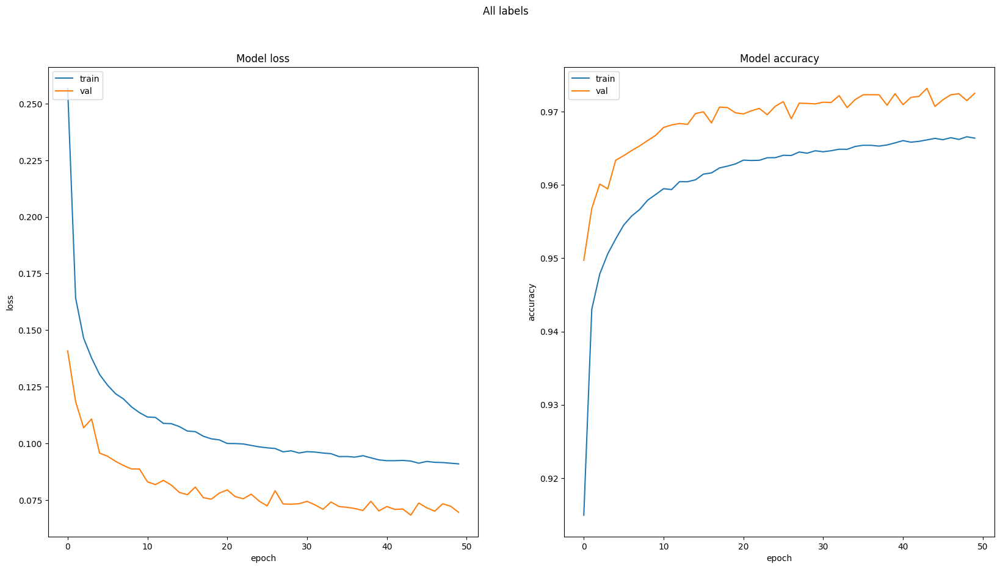

In [20]:
plt.figure(figsize=(20, 10)).suptitle("All labels")
plt.subplot(121)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(122)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.show()

In [21]:
model.save_weights(r'.\checkpoints\eegnet_eyebrows_teeth.weights.h5')

In [22]:
y_pred = model.predict(test_x)
# y_pred.shape, np.argmax(y_pred, 2)[0], np.argmax(test_y[i], 1)
y_pred.shape

315/315 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


(10071, 128, 3)

In [23]:
y_true = test_y
y_pred = np.argmax(y_pred, 2)
y_true.shape, y_pred.shape

((10071, 128), (10071, 128))

In [24]:
from sklearn.metrics import confusion_matrix

cm_total = np.zeros((3, 3))

for y_t, y_p in zip(y_true, y_pred):
    cm = confusion_matrix(y_t, y_p, labels=[0, 1, 2])
    cm = np.array(cm)
    cm_total = cm_total + cm

cm_total


array([[1.03227e+06, 1.73110e+04, 3.17400e+03],
       [1.17580e+04, 2.05871e+05, 6.70000e+01],
       [2.51800e+03, 5.89000e+02, 1.55300e+04]])

In [25]:
result = []
for cls in range(3):
    tp = cm_total[cls, cls]
    fn = np.sum(np.delete(cm_total[cls, :], cls))
    fp = np.sum(np.delete(cm_total[:, cls], cls))
    tn = np.delete(cm_total, cls, axis=0)
    tn = np.sum(np.delete(tn, cls, axis=1))

    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1 = (2 * precision * recall) / (precision + recall)
    acc = (tp + tn) / (tp + fn + tn + fp)
    specifity = tn/(tn+fp)

    result.append([precision, recall, f1, acc, specifity])

print('precision, recall, f1, acc, specifity')
result = np.array(result)
result

precision, recall, f1, acc, specifity


array([[0.98635894, 0.98054153, 0.98344163, 0.97303442, 0.93959371],
       [0.92000751, 0.94568113, 0.93266767, 0.97694106, 0.98329276],
       [0.82734005, 0.83328862, 0.83030368, 0.99507559, 0.99744894]])

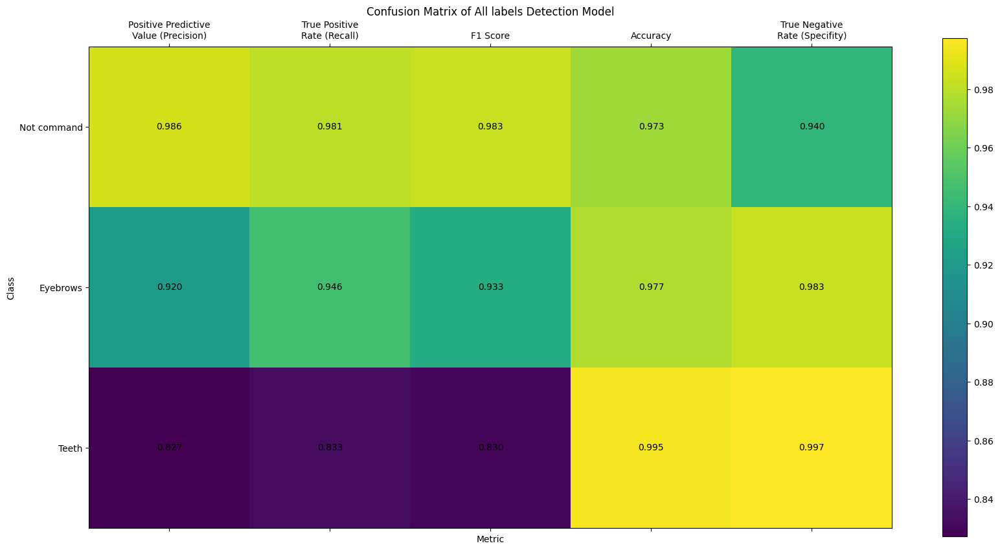

In [26]:
plt.figure(figsize=(20, 10))
plt.title("Confusion Matrix of All labels Detection Model")
plt.matshow(result, fignum=False)
plt.xticks([0, 1, 2, 3, 4], ['Positive Predictive\nValue (Precision)', 'True Positive\nRate (Recall)', 'F1 Score', 'Accuracy', 'True Negative\nRate (Specifity)'])
plt.yticks([0, 1, 2], ['Not command', 'Eyebrows', 'Teeth'])
plt.xlabel("Metric")
plt.ylabel("Class")
for (i, j), z in np.ndenumerate(result):
    plt.text(j, i, '{:0.3f}'.format(z), ha='center', va='center')
plt.colorbar()

In [28]:
y_pred = model.predict(test_x)
# y_pred.shape, np.argmax(y_pred, 2)[0], np.argmax(test_y[i], 1)
y_pred.shape

315/315 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


(10071, 128, 3)

In [29]:
y_true_eyebrows = test_y.copy()
y_true_eyebrows[y_true_eyebrows == 2] = 0
y_pred_eyebrows = np.argmax(y_pred[:, :, [0, 1]], 2)
y_true_eyebrows.shape, y_pred_eyebrows.shape

((10071, 128), (10071, 128))

In [30]:
y_true_teeth = test_y.copy()
y_true_teeth[y_true_teeth == 1] = 0
y_true_teeth[y_true_teeth == 2] = 1
y_pred_teeth = np.argmax(y_pred[:, :, [0, 2]], 2)
y_true_teeth.shape, y_pred_teeth.shape

((10071, 128), (10071, 128))

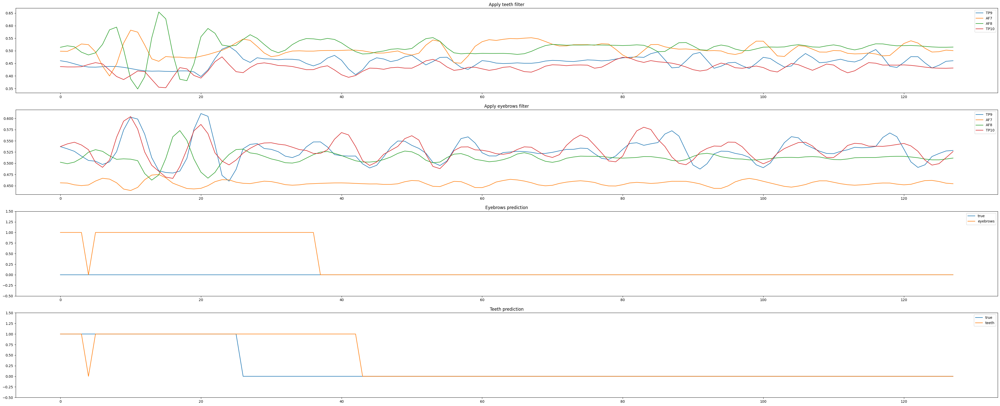

In [46]:
plt.figure(figsize=(50,20))
idx = np.random.randint(0, test_x.shape[0])

plt.subplot(4, 1, 1)
plt.title("Apply teeth filter")
plt.plot(test_x[idx].transpose(1, 0, 2).squeeze(2)[:, :4], label=['TP9', 'AF7', 'AF8', 'TP10'])
plt.legend()

plt.subplot(4, 1, 2)
plt.title("Apply eyebrows filter")
plt.plot(test_x[idx].transpose(1, 0, 2).squeeze(2)[:, 4:], label=['TP9', 'AF7', 'AF8', 'TP10'])
plt.legend()

plt.subplot(4, 1, 3)
plt.gca().set_ylim(-0.5, 1.5)
plt.title("Eyebrows prediction")
plt.plot(y_true_eyebrows[idx], label='true')
plt.plot(y_pred_eyebrows[idx], label='eyebrows')
plt.legend()

plt.subplot(4, 1, 4)
plt.gca().set_ylim(-0.5, 1.5)
plt.title("Teeth prediction")
plt.plot(y_true_teeth[idx], label='true')
plt.plot(y_pred_teeth[idx], label='teeth')
plt.legend()
